In [2]:
!pip install ultralytics
!pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.2/882.2 kB 48.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.4/80.4 kB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 5.6 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


데이터셋 1

In [3]:
from roboflow import Roboflow

In [4]:
rf = Roboflow(api_key="RNnRbjBGhOkE1aA2L1wU")
project = rf.workspace("project-uuw6i").project("pre-eklj4")
version = project.version(4)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Dependency ultralytics==8.0.196 is required but found version=8.3.9, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to pre-4 in yolov8:: 100%|██████████| 13730/13730 [00:01<00:00, 7225.29it/s]


yolo 불러오기

In [8]:
from ultralytics import YOLO
#pt로 불러오는 경우는 이미 사전 훈련된 모델이고, yaml은 새로운 모델은 생성하는것
#yaml, pt 파일을 불러오면 전이된 가중치를 사용하는 것

model = YOLO('yolov8l.yaml').load('yolov8l.pt') #X

100%|██████████| 83.7M/83.7M [00:00<00:00, 219MB/s]


Transferred 559/631 items from pretrained weights


YOLO 전이 학습

In [9]:
#모델 정보
model.info()


#모델 학습
#resume = 마지막 저장 지점에서 훈련을 교육, cache =  데이터 이미지의 활성화, 훈련 속도를 늘리고 메모리 사용량을 늘림
results = model.train(data="/content/pre-4/data.yaml",
                      epochs = 1000,
                      batch = 0.70,
                      imgsz = 640,
                      cache = True,
                      name = "yolo_pre_argumentation_20241010",
                      patience = 50,
                      freeze = 10,
                      project = '/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나',
                      save = True)

YOLOv8l summary: 389 layers, 39,519,744 parameters, 39,519,728 gradients, 146.2 GFLOPs
Ultralytics 8.3.9 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.yaml, data=/content/pre-4/data.yaml, epochs=1000, time=None, patience=50, batch=0.7, imgsz=640, save=True, save_period=-1, cache=True, device=None, workers=8, project=/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나, name=yolo_pre_argumentation_20241010, exist_ok=False, pretrained=yolov8l.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=10, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=Fa

100%|██████████| 755k/755k [00:00<00:00, 14.9MB/s]


Overriding model.yaml nc=80 with nc=11

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  3    279808  ultralytics.nn.modules.block.C2f             [128, 128, 3, True]           
  3                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  4                  -1  6   2101248  ultralytics.nn.modules.block.C2f             [256, 256, 6, True]           
  5                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256, 512, 3, 2]              
  6                  -1  6   8396800  ultralytics.nn.modules.block.C2f             [512, 512, 6, True]           
  7                  -1  1   2360320  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 62.3MB/s]


AMP: checks passed ✅
AutoBatch: Computing optimal batch size for imgsz=640 at 70.0% CUDA memory utilization.
AutoBatch: CUDA:0 (NVIDIA A100-SXM4-40GB) 39.56G total, 0.35G reserved, 0.34G allocated, 38.87G free
      Params      GFLOPs  GPU_mem (GB)  forward (ms) backward (ms)                   input                  output
    39466545       145.9         0.648         78.62         263.2        (1, 3, 640, 640)                    list
    39466545       291.7         0.860         33.22         57.28        (2, 3, 640, 640)                    list
    39466545       583.4         1.313         36.91         44.15        (4, 3, 640, 640)                    list
    39466545        1167         2.147         35.92         41.26        (8, 3, 640, 640)                    list
    39466545        2334         3.892         54.85         45.76       (16, 3, 640, 640)                    list
    39466545        4667         7.980         87.24         61.34       (32, 3, 640, 640)          

train: Scanning /content/pre-4/train/labels... 5997 images, 99 backgrounds, 0 corrupt: 100%|██████████| 5997/5997 [00:04<00:00, 1216.19it/s]


train: New cache created: /content/pre-4/train/labels.cache
WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


train: Caching images (6.9GB RAM): 100%|██████████| 5997/5997 [00:02<00:00, 2247.70it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 1.4.18 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/pre-4/valid/labels... 544 images, 315 backgrounds, 0 corrupt: 100%|██████████| 544/544 [00:00<00:00, 1152.41it/s]

val: New cache created: /content/pre-4/valid/labels.cache


WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


val: Caching images (0.6GB RAM): 100%|██████████| 544/544 [00:00<00:00, 820.01it/s]


Plotting labels to /content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 103 weight(decay=0.0), 110 weight(decay=0.0009609375), 109 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to /content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010
Starting training for 1000 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     1/1000        29G      1.084      3.878      1.371        170        640: 100%|██████████| 49/49 [00:31<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:04<00:00,  1.62s/it]

                   all        544        230    0.00259          1     0.0816     0.0493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     2/1000      28.7G      0.953      2.484      1.152        175        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.05s/it]

                   all        544        230      0.584      0.227      0.223      0.131



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     3/1000      28.7G     0.9477      1.864      1.162        180        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.02s/it]

                   all        544        230      0.522      0.228      0.229      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     4/1000      28.7G     0.9245      1.464      1.171        213        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.06it/s]

                   all        544        230      0.608      0.085      0.159     0.0873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     5/1000      28.8G     0.8634      1.194      1.152        168        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.346       0.32      0.176      0.099



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     6/1000      28.7G     0.8112      1.028      1.122        191        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.334      0.295      0.195      0.111



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     7/1000      28.8G     0.7759     0.9183      1.104        174        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.633      0.409      0.361      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     8/1000      28.8G     0.7434     0.8511      1.084        181        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.493      0.339      0.271      0.156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     9/1000      28.7G     0.7111     0.7871      1.067        192        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.572      0.358      0.305      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    10/1000      28.8G     0.6918     0.7398      1.061        161        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.511      0.437      0.253      0.154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    11/1000      28.8G     0.6675     0.7094      1.046        179        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]

                   all        544        230      0.717      0.333      0.358      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    12/1000      28.8G     0.6427     0.6625      1.037        183        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.564      0.374      0.379      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    13/1000      28.7G     0.6328     0.6571      1.036        162        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.613      0.398      0.411       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    14/1000      28.7G     0.6157     0.6324      1.025        163        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.557       0.39       0.36      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    15/1000      28.8G     0.6081     0.6017      1.021        163        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.668      0.286      0.318      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    16/1000      28.8G     0.5869     0.5704      1.011        163        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.658      0.355      0.409       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    17/1000      28.8G     0.5755      0.565      1.002        171        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.685      0.416      0.437      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    18/1000      28.7G     0.5669     0.5549          1        173        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.691      0.396      0.438      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    19/1000      28.7G     0.5537     0.5361     0.9945        195        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.699      0.425      0.422      0.254



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    20/1000      28.7G      0.554     0.5303     0.9939        171        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]

                   all        544        230      0.716       0.44      0.405      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    21/1000      28.7G     0.5434     0.5257     0.9925        189        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.657      0.375      0.437      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    22/1000      28.7G     0.5363     0.5047     0.9869        180        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.664      0.406      0.407      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    23/1000      28.8G      0.531        0.5     0.9834        168        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.569        0.4      0.353      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    24/1000      28.8G     0.5232     0.4888     0.9764        172        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.611      0.411      0.435      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    25/1000      28.7G     0.5155     0.4776     0.9708        189        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]

                   all        544        230      0.604      0.394      0.456      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    26/1000      28.7G     0.5101     0.4727     0.9743        172        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.648      0.368      0.451      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    27/1000      28.8G     0.5096     0.4748     0.9779        197        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]

                   all        544        230      0.697      0.388      0.471      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    28/1000      28.7G     0.5024     0.4523     0.9715        175        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.617      0.424      0.508      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    29/1000      28.7G     0.4904     0.4408     0.9699        171        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.675       0.42      0.456      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    30/1000      28.7G     0.4948     0.4494     0.9682        154        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230       0.58      0.486      0.521      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    31/1000      28.8G      0.484     0.4414      0.964        173        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.686       0.43      0.423      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    32/1000      28.8G     0.4867     0.4312     0.9609        165        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230       0.67      0.459      0.475      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    33/1000      28.7G     0.4773     0.4268     0.9571        200        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.674      0.415       0.47      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    34/1000      28.7G     0.4772     0.4267     0.9541        183        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.741      0.375      0.485      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    35/1000      28.8G     0.4731     0.4143     0.9528        169        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.589      0.451      0.483      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    36/1000      28.7G     0.4693     0.4202     0.9605        180        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.703       0.42      0.486       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    37/1000      28.8G     0.4663     0.4124     0.9559        166        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.595      0.452       0.51      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    38/1000      28.8G     0.4673     0.4045     0.9551        184        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.04s/it]

                   all        544        230      0.655      0.458      0.475      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    39/1000      28.7G     0.4564     0.4015     0.9467        179        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230        0.7      0.431      0.476      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    40/1000      28.7G     0.4543     0.3971     0.9497        180        640: 100%|██████████| 49/49 [00:30<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.638       0.46      0.464      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    41/1000      28.7G     0.4545      0.395     0.9533        174        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.707      0.413      0.517      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    42/1000      28.8G     0.4495     0.3883     0.9468        175        640: 100%|██████████| 49/49 [00:30<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.599       0.41      0.485      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    43/1000      28.8G     0.4466     0.3831     0.9403        184        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.704       0.44      0.492      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    44/1000      28.7G     0.4442     0.3911     0.9403        172        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.683       0.48      0.516      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    45/1000      28.8G      0.441     0.3891      0.941        155        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.715      0.431      0.474      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    46/1000      28.7G     0.4397     0.3744     0.9419        195        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.604      0.448      0.496      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    47/1000      28.8G     0.4363     0.3782     0.9433        185        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.606      0.483      0.562      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    48/1000      28.8G     0.4395     0.3717     0.9489        180        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.721      0.472      0.561       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    49/1000      28.7G     0.4323     0.3686     0.9384        152        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.724      0.478      0.543      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    50/1000      28.7G     0.4302     0.3693      0.944        200        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.717      0.471      0.551      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    51/1000      28.7G     0.4236      0.357      0.939        193        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.659      0.499      0.531      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    52/1000      28.8G      0.425     0.3553     0.9352        168        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.696      0.465      0.535      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    53/1000      28.8G     0.4233     0.3571     0.9385        167        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.583      0.431      0.513      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    54/1000      28.8G     0.4216     0.3591      0.938        185        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]

                   all        544        230      0.664      0.474       0.46      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    55/1000      28.8G     0.4259     0.3633     0.9422        172        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.668      0.437      0.503      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    56/1000        29G     0.4215     0.3596     0.9397        177        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.724      0.434      0.486       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    57/1000      28.8G     0.4178     0.3554     0.9344        161        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.666      0.492      0.482      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    58/1000      28.8G     0.4127     0.3418     0.9271        188        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230       0.69      0.484      0.524      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    59/1000      28.7G     0.4142      0.345     0.9289        175        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.563      0.466       0.49      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    60/1000      28.8G     0.4154     0.3494     0.9377        192        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.693      0.444      0.497      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    61/1000      28.8G     0.4141     0.3474      0.935        167        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.686       0.48      0.498       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    62/1000      28.7G     0.4053      0.342     0.9283        189        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.682       0.46      0.475      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    63/1000      28.8G     0.4027      0.339     0.9304        173        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.684      0.467      0.502      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    64/1000      28.8G     0.4075     0.3437      0.931        184        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.788      0.458       0.55      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    65/1000      28.7G     0.4048     0.3388     0.9271        162        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.715      0.431      0.512      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    66/1000      28.8G     0.4018     0.3323     0.9317        178        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.658      0.477        0.5      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    67/1000      28.8G     0.3996       0.33     0.9308        170        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.702      0.465      0.514      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    68/1000      28.8G     0.4023     0.3308      0.932        180        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.704      0.456      0.538      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    69/1000      28.7G     0.3982     0.3316     0.9313        170        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230       0.59       0.48      0.473      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    70/1000      28.7G     0.3948     0.3285     0.9294        172        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.729      0.509      0.543      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    71/1000      28.7G     0.3977     0.3269     0.9265        182        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.707      0.469      0.463      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    72/1000      28.8G     0.3995     0.3337     0.9305        184        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.721      0.496      0.571       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    73/1000      28.7G     0.3892     0.3286     0.9263        187        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.592      0.504      0.546      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    74/1000      28.8G     0.3944     0.3268     0.9267        188        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230       0.64      0.498      0.606      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    75/1000      28.7G     0.3983     0.3329     0.9239        174        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230       0.61      0.487      0.496      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    76/1000      28.8G       0.39     0.3272     0.9162        181        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.746      0.504      0.606      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    77/1000      28.8G     0.3909      0.324     0.9226        172        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.768      0.498      0.587      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    78/1000      28.8G     0.3856     0.3158     0.9174        151        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.618      0.466      0.568      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    79/1000      28.7G     0.3816      0.317     0.9173        185        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.709      0.465      0.525      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    80/1000      28.8G     0.3871       0.32     0.9196        190        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.637      0.438      0.528      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    81/1000      28.8G     0.3836     0.3132     0.9192        181        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230       0.67      0.496      0.543      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    82/1000      28.8G     0.3834     0.3148     0.9209        189        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.756      0.513      0.616       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    83/1000      28.8G     0.3783     0.3172     0.9238        175        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.703       0.48      0.571      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    84/1000      28.8G     0.3756     0.3042     0.9135        176        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.717      0.503      0.555      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    85/1000      28.7G     0.3815     0.3034     0.9176        189        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.736      0.497      0.533      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    86/1000      28.7G     0.3767     0.3032     0.9124        164        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.05it/s]

                   all        544        230      0.554      0.446      0.609      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    87/1000      28.8G     0.3779     0.3045     0.9161        197        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.711       0.46      0.558      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    88/1000      28.7G     0.3775     0.3089     0.9116        163        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.614      0.464      0.596       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    89/1000      28.7G     0.3738      0.299     0.9106        153        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.613      0.451      0.539      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    90/1000      28.7G     0.3768      0.308     0.9136        162        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.657       0.47      0.513      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    91/1000      28.8G     0.3699     0.2964     0.9136        170        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.614      0.471      0.557      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    92/1000      28.8G     0.3735     0.3045     0.9139        155        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.747      0.499      0.581      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    93/1000      28.7G     0.3665     0.2968     0.9099        193        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.601      0.464      0.579      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    94/1000      28.8G      0.373      0.304     0.9161        157        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230       0.57      0.506      0.525      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    95/1000      28.8G     0.3716     0.2991     0.9182        201        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.446      0.457       0.52       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    96/1000      28.7G     0.3676     0.3009      0.912        164        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.713      0.496      0.536       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    97/1000      28.7G     0.3668     0.2969      0.915        178        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.639        0.5      0.546      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    98/1000      28.8G     0.3732      0.299     0.9186        195        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.677      0.476      0.546      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    99/1000      28.7G     0.3697     0.2928      0.918        173        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.722        0.5      0.597      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   100/1000      28.7G     0.3689     0.2944     0.9135        192        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.645      0.511      0.599      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   101/1000      28.7G     0.3675     0.3003     0.9131        168        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.724      0.483      0.556      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   102/1000      28.7G     0.3658     0.2972     0.9145        180        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.726      0.477      0.569      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   103/1000      28.7G     0.3626     0.2925     0.9097        163        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.533      0.475      0.552      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   104/1000      28.8G     0.3644     0.2895      0.914        160        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.582      0.495      0.543      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   105/1000      28.7G     0.3645     0.2935     0.9118        178        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230       0.62      0.526      0.578      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   106/1000      28.8G     0.3676     0.2892     0.9119        164        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.647      0.522      0.599      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   107/1000      28.8G     0.3619     0.2894     0.9112        190        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.655      0.518      0.583      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   108/1000      28.7G     0.3596     0.2887     0.9081        189        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230       0.68      0.529       0.52      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   109/1000      28.7G     0.3614       0.29     0.9103        176        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.584      0.498      0.529       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   110/1000      28.7G     0.3545     0.2793     0.9086        192        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.651      0.523      0.588      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   111/1000      28.7G     0.3578     0.2849     0.9078        173        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230       0.73      0.472      0.536      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   112/1000      28.7G     0.3588     0.2857     0.9104        173        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.582      0.501      0.526       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   113/1000      28.7G     0.3542     0.2795     0.9082        161        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.594      0.513      0.554      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   114/1000      28.7G     0.3586     0.2922     0.9077        176        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.614      0.498      0.557      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   115/1000      28.8G     0.3579      0.284     0.9084        178        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230       0.69      0.524      0.538      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   116/1000      28.8G     0.3527     0.2816     0.9074        175        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.604       0.51      0.569      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   117/1000      28.8G     0.3543     0.2831     0.9046        170        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.667      0.497      0.522      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   118/1000      28.7G     0.3517     0.2799     0.9085        154        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]

                   all        544        230      0.664      0.524      0.563      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   119/1000      28.8G     0.3524     0.2768     0.9092        191        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.589      0.496      0.553      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   120/1000      28.7G      0.352     0.2796     0.9112        178        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.599      0.487      0.564      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   121/1000      28.8G     0.3542     0.2811     0.9112        169        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.727      0.474      0.526      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   122/1000      28.8G     0.3547     0.2783     0.9085        188        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.705      0.519      0.561      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   123/1000      28.7G     0.3489      0.279     0.8999        165        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.734       0.48       0.58      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   124/1000      28.7G     0.3526     0.2829     0.9068        171        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.753      0.497      0.623      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   125/1000      28.8G     0.3496     0.2734     0.9066        184        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.787      0.526      0.599      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   126/1000      28.7G     0.3453     0.2774     0.9032        197        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.749      0.504      0.584       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   127/1000      28.7G     0.3515     0.2754     0.9021        170        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.706      0.494      0.568      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   128/1000      28.8G      0.344     0.2757     0.9039        159        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.673      0.508      0.567      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   129/1000      28.7G     0.3486     0.2756     0.9043        178        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.719      0.514       0.58      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   130/1000      28.8G     0.3426     0.2717     0.9014        181        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.726      0.517      0.585       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   131/1000      28.8G      0.341     0.2728        0.9        195        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.722      0.489      0.557      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   132/1000      28.8G     0.3379     0.2685     0.9012        168        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230       0.65      0.506      0.605      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   133/1000      28.8G     0.3422     0.2726     0.8995        181        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.615      0.496       0.57      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   134/1000      28.7G     0.3465     0.2721     0.9002        172        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.632      0.489      0.571      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   135/1000      28.7G     0.3483      0.269     0.9071        183        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.733      0.491      0.564      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   136/1000      28.8G     0.3443     0.2704     0.9004        173        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230       0.69      0.506      0.558      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   137/1000      28.8G     0.3427     0.2723     0.9025        162        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.719      0.488      0.541      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   138/1000      28.8G     0.3423     0.2694     0.9002        161        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]

                   all        544        230      0.609      0.509      0.516      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   139/1000      28.7G      0.346     0.2728     0.8998        176        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.627      0.503      0.532      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   140/1000      28.7G     0.3378     0.2718     0.9056        171        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.611      0.506      0.579      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   141/1000      28.7G     0.3399     0.2684     0.8974        187        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.598      0.518      0.558      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   142/1000      28.7G     0.3414     0.2702     0.8972        182        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.706      0.485      0.536      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   143/1000      28.7G     0.3395     0.2663     0.9034        168        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.718      0.477      0.535      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   144/1000      28.8G     0.3406     0.2705     0.9035        179        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.721       0.51      0.581      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   145/1000      28.7G     0.3328     0.2632     0.8986        209        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.692      0.505      0.575      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   146/1000      28.8G     0.3434     0.2684     0.9001        169        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.703      0.507       0.54      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   147/1000      28.7G     0.3442     0.2718     0.8967        164        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.718      0.496       0.52      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   148/1000      28.8G     0.3419     0.2652     0.8897        193        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.757      0.506      0.575      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   149/1000      28.8G     0.3417     0.2659     0.9022        171        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.659      0.522      0.593      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   150/1000      28.8G     0.3416     0.2701      0.898        166        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.628       0.48      0.597      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   151/1000      28.7G     0.3373      0.264     0.8966        176        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.648      0.487      0.588      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   152/1000      28.8G     0.3364     0.2661      0.898        172        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.591      0.498      0.544       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   153/1000      28.8G     0.3329     0.2607     0.8952        196        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.717      0.519       0.58      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   154/1000      28.8G     0.3311     0.2612     0.8983        180        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.718      0.512      0.588      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   155/1000      28.7G     0.3339     0.2628     0.9015        164        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.691      0.499      0.568      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   156/1000      28.8G      0.335     0.2587     0.8996        188        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230       0.65      0.515      0.616       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   157/1000      28.8G      0.332     0.2589      0.896        183        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.617      0.507      0.597      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   158/1000      28.7G     0.3324     0.2646     0.8947        174        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.638      0.499      0.597      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   159/1000      28.7G     0.3344     0.2612      0.894        180        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.572      0.505      0.605      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   160/1000      28.8G     0.3376     0.2641     0.9008        165        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.612      0.458      0.559      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   161/1000      28.7G     0.3365     0.2683     0.8992        168        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230       0.58      0.476      0.558      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   162/1000      28.8G      0.333     0.2583     0.8996        165        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.624      0.489      0.548      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   163/1000      28.8G     0.3314     0.2618     0.8993        174        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.688      0.478      0.556       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   164/1000      28.7G     0.3304     0.2574     0.8982        181        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.706      0.473      0.593      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   165/1000      28.7G     0.3303     0.2586     0.8945        171        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.733      0.475      0.593      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   166/1000      28.8G     0.3288     0.2582     0.8914        180        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.693      0.489      0.554      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   167/1000      28.7G     0.3325      0.258     0.8944        188        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all        544        230      0.712      0.491      0.574      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   168/1000      28.8G     0.3269     0.2558     0.8916        163        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.593      0.495      0.571      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   169/1000      28.7G     0.3328     0.2564     0.8991        182        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]

                   all        544        230      0.619      0.478      0.573      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   170/1000      28.8G     0.3332      0.261     0.8951        161        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.12it/s]

                   all        544        230      0.617      0.473      0.566      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   171/1000      28.8G     0.3234     0.2516     0.8924        158        640: 100%|██████████| 49/49 [00:30<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.715      0.468      0.533      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   172/1000      28.7G     0.3269     0.2541     0.8916        187        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]

                   all        544        230      0.627      0.468      0.551      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   173/1000      28.7G     0.3338     0.2583     0.8972        184        640: 100%|██████████| 49/49 [00:29<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.12it/s]

                   all        544        230      0.632      0.463      0.548      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   174/1000      28.7G     0.3258     0.2534     0.8955        175        640: 100%|██████████| 49/49 [00:29<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]

                   all        544        230      0.629      0.472      0.572      0.324
EarlyStopping: Training stopped early as no improvement observed in last 50 epochs. Best results observed at epoch 124, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



174 epochs completed in 1.651 hours.
Optimizer stripped from /content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/weights/last.pt, 79.4MB
Optimizer stripped from /content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/weights/best.pt, 79.4MB

Validating /content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/weights/best.pt...
WARNING ⚠️ validating an untrained model YAML will result in 0 mAP.
Ultralytics 8.3.9 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8l summary (fused): 286 layers, 39,441,265 parameters, 0 gradients, 145.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]


                   all        544        230      0.752      0.495      0.625      0.373
           36.Rjohnson         20         20      0.419        0.5      0.506      0.334
             37.Rnixon         10         10      0.651        0.8      0.878      0.568
              38.Jford         10         10      0.337          1      0.861      0.484
            39.Jcarter         10         10          1      0.693       0.73      0.407
            40.Rreagan         10         10        0.4      0.869      0.729      0.411
           42.Bclinton         10         10      0.715          1       0.92      0.576
              43.Jbush         16         16          1     0.0873       0.27       0.19
             44.Bobama        121        121          1          0      0.738      0.373
             45.Dtrupm         12         12          1          0      0.317      0.197
             46.Jbiden         11         11          1          0      0.304       0.19
Speed: 0.1ms preproce

In [6]:
from ultralytics import YOLO

In [7]:
import os
import glob
import pandas as pd

# 모델 로드
model = YOLO('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/weights/best.pt')

# 테스트 데이터셋 경로
test_images_path = "/content/pre-4/test/images/*.jpg"
label_path = "/content/pre-4/test/labels"

# 예측 결과와 실제 레이블 저장을 위한 리스트
results = []

# 이미지 파일 목록 가져오기
test_images = glob.glob(test_images_path)

for img in test_images:
    # 실제 레이블 로드
    label_file = os.path.join(label_path, os.path.basename(img).replace('.jpg', '.txt'))
    true_labels = []

    if os.path.exists(label_file):
        with open(label_file, 'r') as f:
            true_labels = [int(line.strip().split()[0]) for line in f.readlines()]

    # 모델 예측
    result = model.predict(img, imgsz=640,save = True)

    # 예측 클래스 수집
    predicted_classes = []
    for r in result:
        if r.boxes is not None and len(r.boxes.cls) > 0:
            predictions_with_classes = r.boxes.cls.tolist()
            predicted_classes.extend(predictions_with_classes)

    # 결과 저장 (예측 클래스와 실제 클래스)
    results.append({
        "image": os.path.basename(img),
        "true": true_labels,  # 실제 클래스 (리스트로 저장)
        "predicted": predicted_classes  # 예측된 클래스 (리스트로 저장)
    })

# DataFrame으로 변환
df = pd.DataFrame(results)

# CSV 파일로 저장 (리스트를 문자열로 변환하여 저장)
df['true'] = df['true'].apply(lambda x: ', '.join(map(str, x)))
df['predicted'] = df['predicted'].apply(lambda x: ', '.join(map(str, x)))

# CSV 파일로 저장
df.to_csv('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/robo_20241010.csv', index=False)
print("CSV 파일로 저장 완료:")



image 1/1 /content/pre-4/test/images/20230601_191723_14_jpg.rf.f1970f146b7f6647f4adb85cb982faef.jpg: 640x640 1 46.Jbiden, 12.2ms
Speed: 11.7ms preprocess, 12.2ms inference, 792.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict

image 1/1 /content/pre-4/test/images/Joe-Biden_15_jpeg.rf.4e9a01da88c2493e6d07feb3456c6347.jpg: 640x640 (no detections), 12.2ms
Speed: 2.1ms preprocess, 12.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict

image 1/1 /content/pre-4/test/images/20230601_192054_18_jpg.rf.c22f8e5d819848bbb53908378618a0b7.jpg: 640x640 1 37.Rnixon, 1 39.Jcarter, 11.5ms
Speed: 1.5ms preprocess, 11.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict

image 1/1 /content/pre-4/test/images/20230601_192100_28_jpg.rf.0f3e2b71e1a15a9752f4188a0288d6d3.jpg: 640x640 1 46.Jbiden, 11.9ms
Speed: 2.1ms preprocess, 11.9ms inference, 1.3ms postprocess p

#csv 파일 열어서 라벨 분리

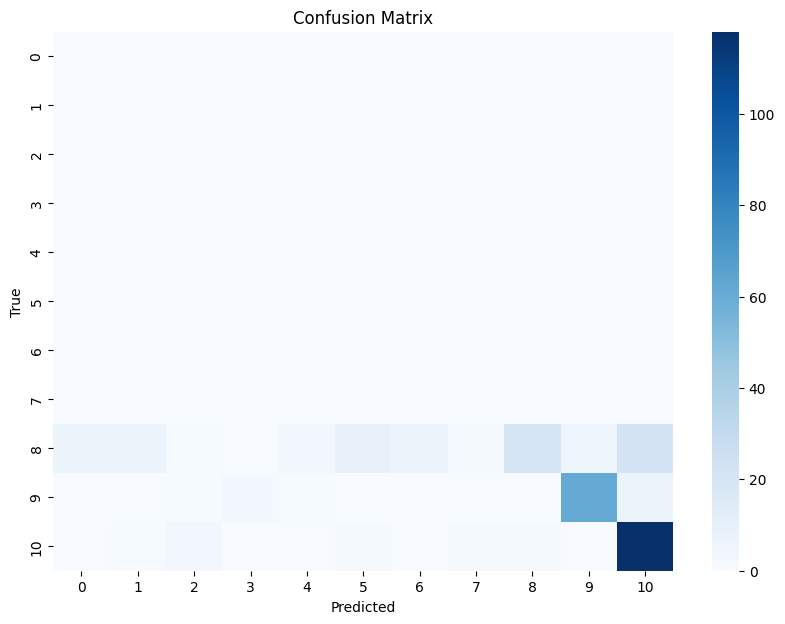

In [10]:
import pandas as pd
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Load the CSV file
df = pd.read_csv('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/robo_20241010.csv')

# Drop rows where either true or predicted is missing
df.dropna(subset=['true', 'predicted'], inplace=True)

# Clean and prepare the 'predicted' column
df['predicted'] = df['predicted'].apply(lambda x: float(str(x).split(',')[0]) if ',' in str(x) else float(x))

# Expand rows where 'true' has multiple values
df_expanded = df['true'].str.split(',', expand=True).stack().reset_index(level=1, drop=True)
df = df.drop(columns=['true']).join(df_expanded.rename('true'))

# Convert columns to appropriate types
df['true'] = df['true'].astype(int)
df['predicted'] = df['predicted'].astype(int)

# Create the confusion matrix
cm = confusion_matrix(df['true'], df['predicted'])

# Plot the confusion matrix
plt.figure(figsize=(10,7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


In [12]:
import numpy as np

invalid value encountered in divide


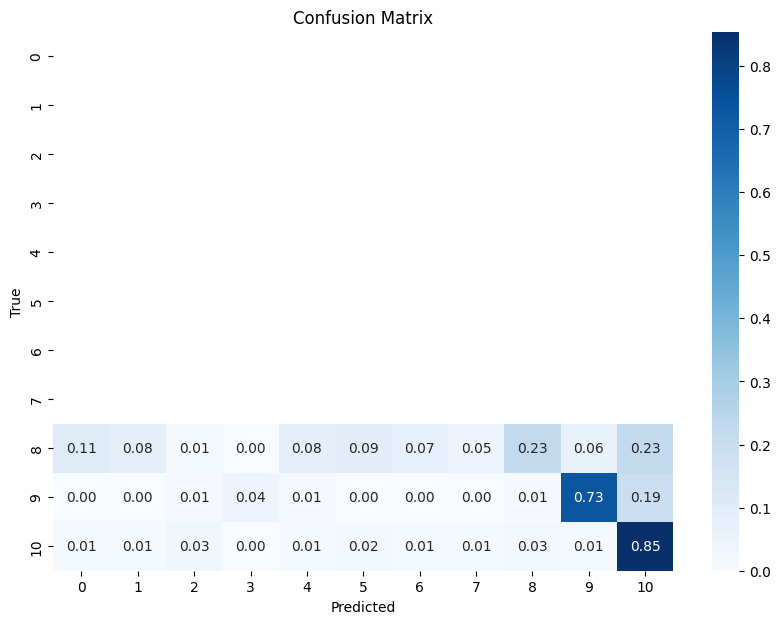

In [14]:
import pandas as pd
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# CSV 파일 읽기
df = pd.read_csv('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/robo_20241010.csv')

# 'true' 또는 'predicted' 값이 비어있는 행 제거
df.dropna(subset=['true', 'predicted'], inplace=True)

# 'predicted' 컬럼 처리 (예측 값이 여러 개인 경우 리스트로 변환)
df['predicted'] = df['predicted'].apply(lambda x: [float(pred) for pred in str(x).split(',')] if pd.notnull(x) else [])

# 'true' 값이 여러 개인 경우 각 값을 나눠서 처리
df['true'] = df['true'].apply(lambda x: [float(true) for true in str(x).split(',')] if pd.notnull(x) else [])

# 각 true 값에 대해 모든 predicted 값 조합 생성
expanded_rows = []
for index, row in df.iterrows():
    for true_value in row['true']:
        for pred_value in row['predicted']:
            expanded_rows.append({'true': true_value, 'predicted': pred_value})

# 새로운 DataFrame 생성
expanded_df = pd.DataFrame(expanded_rows)

# 데이터 타입을 정수형으로 변환
expanded_df['true'] = expanded_df['true'].astype(int)
expanded_df['predicted'] = expanded_df['predicted'].astype(int)

# 혼동행렬 생성
cm = confusion_matrix(expanded_df['true'], expanded_df['predicted'])

# 혼동행렬을 비율로 변환
cm_percentage = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# 혼동행렬 시각화 (비율)
plt.figure(figsize=(10, 7))
sns.heatmap(cm_percentage, annot=True, fmt='.2f', cmap='Blues', cbar=True,
            xticklabels=range(cm.shape[1]), yticklabels=range(cm.shape[0]))
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


In [15]:

rf = Roboflow(api_key="RNnRbjBGhOkE1aA2L1wU")
project = rf.workspace("project-uuw6i").project("test-lyhxc")
version = project.version(4)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.3.9, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to test-4 in yolov8:: 100%|██████████| 228/228 [00:00<00:00, 7080.30it/s]


In [16]:
import os
import glob
import pandas as pd

# 모델 로드
model = YOLO('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/weights/best.pt')

# 테스트 데이터셋 경로
test_images_path = "/content/test-4/test/images/*.jpg"
label_path = "/content/test-4/test/labels"

# 예측 결과와 실제 레이블 저장을 위한 리스트
results = []

# 이미지 파일 목록 가져오기
test_images = glob.glob(test_images_path)

for img in test_images:
    # 실제 레이블 로드
    label_file = os.path.join(label_path, os.path.basename(img).replace('.jpg', '.txt'))
    true_labels = []

    if os.path.exists(label_file):
        with open(label_file, 'r') as f:
            true_labels = [int(line.strip().split()[0]) for line in f.readlines()]

    # 모델 예측
    result = model.predict(img, imgsz=640,save = True)

    # 예측 클래스 수집
    predicted_classes = []
    for r in result:
        if r.boxes is not None and len(r.boxes.cls) > 0:
            predictions_with_classes = r.boxes.cls.tolist()
            predicted_classes.extend(predictions_with_classes)

    # 결과 저장 (예측 클래스와 실제 클래스)
    results.append({
        "image": os.path.basename(img),
        "true": true_labels,  # 실제 클래스 (리스트로 저장)
        "predicted": predicted_classes  # 예측된 클래스 (리스트로 저장)
    })

# DataFrame으로 변환
df = pd.DataFrame(results)

# CSV 파일로 저장 (리스트를 문자열로 변환하여 저장)
df['true'] = df['true'].apply(lambda x: ', '.join(map(str, x)))
df['predicted'] = df['predicted'].apply(lambda x: ', '.join(map(str, x)))

# CSV 파일로 저장
df.to_csv('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/robo_test_20241010.csv', index=False)
print("CSV 파일로 저장 완료:")



image 1/1 /content/test-4/test/images/images_jpg.rf.cab5bc7df0db353768edd2a7b42adc14.jpg: 640x640 1 36.Rjohnson, 12.5ms
Speed: 1.7ms preprocess, 12.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict2

image 1/1 /content/test-4/test/images/images_jpg.rf.4551255faaf2cd70b7a8a9b6de88c632.jpg: 640x640 1 39.Jcarter, 11.3ms
Speed: 1.5ms preprocess, 11.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict2

image 1/1 /content/test-4/test/images/images_jpg.rf.df8e1db0e2d954044c1bf32735fd8f89.jpg: 640x640 1 37.Rnixon, 11.1ms
Speed: 1.4ms preprocess, 11.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict2

image 1/1 /content/test-4/test/images/images_jpg.rf.4dcf618a4b98bc162de96dc2aaf23008.jpg: 640x640 1 38.Jford, 11.2ms
Speed: 1.4ms preprocess, 11.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to run

In [18]:
import os
import glob
import pandas as pd

# 모델 로드
model = YOLO('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/weights/last.pt')

# 테스트 데이터셋 경로
test_images_path = "/content/test-4/test/images/*.jpg"
label_path = "/content/test-4/test/labels"

# 예측 결과와 실제 레이블 저장을 위한 리스트
results = []

# 이미지 파일 목록 가져오기
test_images = glob.glob(test_images_path)

for img in test_images:
    # 실제 레이블 로드
    label_file = os.path.join(label_path, os.path.basename(img).replace('.jpg', '.txt'))
    true_labels = []

    if os.path.exists(label_file):
        with open(label_file, 'r') as f:
            true_labels = [int(line.strip().split()[0]) for line in f.readlines()]

    # 모델 예측
    result = model.predict(img, imgsz=640,save = True)

    # 예측 클래스 수집
    predicted_classes = []
    for r in result:
        if r.boxes is not None and len(r.boxes.cls) > 0:
            predictions_with_classes = r.boxes.cls.tolist()
            predicted_classes.extend(predictions_with_classes)

    # 결과 저장 (예측 클래스와 실제 클래스)
    results.append({
        "image": os.path.basename(img),
        "true": true_labels,  # 실제 클래스 (리스트로 저장)
        "predicted": predicted_classes  # 예측된 클래스 (리스트로 저장)
    })

# DataFrame으로 변환
df = pd.DataFrame(results)

# CSV 파일로 저장 (리스트를 문자열로 변환하여 저장)
df['true'] = df['true'].apply(lambda x: ', '.join(map(str, x)))
df['predicted'] = df['predicted'].apply(lambda x: ', '.join(map(str, x)))

# CSV 파일로 저장
df.to_csv('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/robo_test_20241010last.pt.csv', index=False)
print("CSV 파일로 저장 완료:")



image 1/1 /content/test-4/test/images/images_jpg.rf.cab5bc7df0db353768edd2a7b42adc14.jpg: 640x640 1 36.Rjohnson, 13.9ms
Speed: 2.1ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3

image 1/1 /content/test-4/test/images/images_jpg.rf.4551255faaf2cd70b7a8a9b6de88c632.jpg: 640x640 1 39.Jcarter, 11.9ms
Speed: 1.6ms preprocess, 11.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3

image 1/1 /content/test-4/test/images/images_jpg.rf.df8e1db0e2d954044c1bf32735fd8f89.jpg: 640x640 1 36.Rjohnson, 1 37.Rnixon, 1 38.Jford, 11.8ms
Speed: 1.4ms preprocess, 11.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3

image 1/1 /content/test-4/test/images/images_jpg.rf.4dcf618a4b98bc162de96dc2aaf23008.jpg: 640x640 1 42.Bclinton, 12.3ms
Speed: 1.5ms preprocess, 12.3ms inference, 1.2ms postprocess per image at shape (1, 3, 

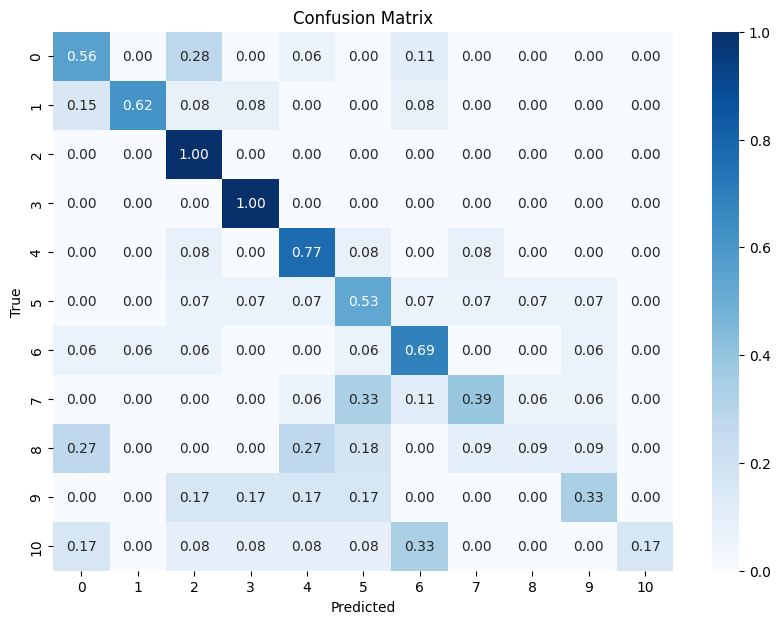

In [19]:
import pandas as pd
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# CSV 파일 읽기
df = pd.read_csv('/content/drive/Shareddrives/AI 개발자 Project/03 Final Project/조하나/yolo_pre_argumentation_20241010/robo_test_20241010last.pt.csv')

# 'true' 또는 'predicted' 값이 비어있는 행 제거
df.dropna(subset=['true', 'predicted'], inplace=True)

# 'predicted' 컬럼 처리 (예측 값이 여러 개인 경우 리스트로 변환)
df['predicted'] = df['predicted'].apply(lambda x: [float(pred) for pred in str(x).split(',')] if pd.notnull(x) else [])

# 'true' 값이 여러 개인 경우 각 값을 나눠서 처리
df['true'] = df['true'].apply(lambda x: [float(true) for true in str(x).split(',')] if pd.notnull(x) else [])

# 각 true 값에 대해 모든 predicted 값 조합 생성
expanded_rows = []
for index, row in df.iterrows():
    for true_value in row['true']:
        for pred_value in row['predicted']:
            expanded_rows.append({'true': true_value, 'predicted': pred_value})

# 새로운 DataFrame 생성
expanded_df = pd.DataFrame(expanded_rows)

# 데이터 타입을 정수형으로 변환
expanded_df['true'] = expanded_df['true'].astype(int)
expanded_df['predicted'] = expanded_df['predicted'].astype(int)

# 혼동행렬 생성
cm = confusion_matrix(expanded_df['true'], expanded_df['predicted'])

# 혼동행렬을 비율로 변환
cm_percentage = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# 혼동행렬 시각화 (비율)
plt.figure(figsize=(10, 7))
sns.heatmap(cm_percentage, annot=True, fmt='.2f', cmap='Blues', cbar=True,
            xticklabels=range(cm.shape[1]), yticklabels=range(cm.shape[0]))
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
import shutil

# Define the source directory and the zip file path
source_dir = '/content/runs/detect/trum_yolov8m2/'
zip_file_path = '/content/runs/detect/trum_yolov8m2.zip'

# Create a zip file from the directory
shutil.make_archive(zip_file_path.replace('.zip', ''), 'zip', source_dir)



'/content/runs/detect/trum_yolov8m2.zip'

In [ ]:
from google.colab import files
files.download(zip_file_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# 모델 검증 마지막 모델의 val 생략가능
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map  # map50-95 평균 precision
metrics.box.map50  # map50 50%가 겹칠때 precision
metrics.box.map75  # map75
metrics.box.maps  # 각 카테고리에 대해 계산된 mAP 값이 배열로 저장됨

Ultralytics 8.3.3 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m summary (fused): 236 layers, 23,203,411 parameters, 0 gradients, 67.4 GFLOPs


val: Scanning /content/Trump-1/valid/labels.cache... 72 images, 0 backgrounds, 0 corrupt: 100%|██████████| 72/72 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.02it/s]


                   all         72         72      0.932      0.972      0.975      0.764
Speed: 0.4ms preprocess, 24.9ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to runs/detect/trum_yolov8m22


array([    0.76429])

교육 재개

In [ ]:
model = YOLO("runs/detect/trum_yolov8m2/weights/last.pt")

In [ ]:
# 모델을 불러와서 계속해서 학습을 하고 싶을 때는 아래 경로를 수정해서 어떠한 모델을 사용할건지 불러와서 사용하면 된다.
#그리고 그대로 가중치를 이어가고 싶다면 resume를 적용한다.


# model = YOLO('runs/train/trum_yolov8m/weights/best.pt')

# Resume training
results = model.train(data="/content/Trump-2/data.yaml",
                      epochs=200,
                      batch=0.70,
                      imgsz=640,
                      cache = False,
                      name = "trum_yolov8m_2",
                      save=True)

Ultralytics 8.3.3 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=runs/detect/trum_yolov8m2/weights/last.pt, data=/content/Trump-2/data.yaml, epochs=200, time=None, patience=100, batch=0.7, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=trum_yolov8m_2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, sho

100%|██████████| 5.35M/5.35M [00:00<00:00, 82.1MB/s]


AMP: checks passed ✅
AutoBatch: Computing optimal batch size for imgsz=640 at 70.0% CUDA memory utilization.
AutoBatch: CUDA:0 (Tesla T4) 14.75G total, 1.02G reserved, 0.56G allocated, 13.17G free
      Params      GFLOPs  GPU_mem (GB)  forward (ms) backward (ms)                   input                  output
    23221699       67.84         1.153         38.04         33.98        (1, 3, 640, 640)                    list
    23221699       135.7         1.216         36.61         54.79        (2, 3, 640, 640)                    list
    23221699       271.3         2.036         140.2         107.8        (4, 3, 640, 640)                    list
    23221699       542.7         3.599         136.9         115.5        (8, 3, 640, 640)                    list
    23221699        1085         6.682         152.5         175.8       (16, 3, 640, 640)                    list
AutoBatch: Using batch-size 22 for CUDA:0 10.50G/14.75G (71%) ✅


train: Scanning /content/Trump-2/train/labels... 514 images, 0 backgrounds, 0 corrupt: 100%|██████████| 514/514 [00:00<00:00, 514.82it/s]

train: New cache created: /content/Trump-2/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/Trump-2/valid/labels... 61 images, 0 backgrounds, 0 corrupt: 100%|██████████| 61/61 [00:00<00:00, 473.40it/s]

val: New cache created: /content/Trump-2/valid/labels.cache


Plotting labels to runs/detect/trum_yolov8m_2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 83 weight(decay=0.0), 90 weight(decay=0.000515625), 89 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/trum_yolov8m_2
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/200      9.65G      1.278     0.9234      1.261         17        640: 100%|██████████| 24/24 [00:19<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]

                   all         61         61       0.84      0.861      0.901       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/200      9.61G      1.164     0.7701      1.166         20        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         61         61      0.892      0.951      0.938      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/200      9.68G      1.187     0.7972       1.18         18        640: 100%|██████████| 24/24 [00:18<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61      0.788      0.689      0.818       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/200      9.69G      1.161     0.7871      1.222         17        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all         61         61      0.818      0.885      0.925      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/200      9.68G      1.165     0.8056      1.221         17        640: 100%|██████████| 24/24 [00:17<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61       0.86      0.852      0.915      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/200      9.69G      1.176     0.7556      1.223         16        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.05s/it]

                   all         61         61      0.897      0.852      0.937      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/200      9.68G       1.12     0.7247      1.186         18        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.54it/s]

                   all         61         61      0.886      0.934      0.946      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/200      9.69G      1.145     0.7265      1.199         13        640: 100%|██████████| 24/24 [00:19<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]

                   all         61         61      0.849      0.925      0.909      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/200      9.68G      1.109     0.7075      1.183         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.24it/s]

                   all         61         61      0.915      0.878      0.941      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/200      9.69G      1.091     0.6729      1.175         19        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all         61         61      0.785      0.672      0.739      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/200      9.68G      1.089     0.6499       1.16         16        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         61         61      0.773       0.77      0.859      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/200      9.68G      1.128      0.738      1.194         18        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.24it/s]

                   all         61         61      0.712      0.885      0.788       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/200      9.68G        1.1     0.6769      1.185         17        640: 100%|██████████| 24/24 [00:16<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.02s/it]

                   all         61         61      0.942      0.918      0.928       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/200      9.68G      1.065     0.6725      1.164         21        640: 100%|██████████| 24/24 [00:18<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.05s/it]

                   all         61         61      0.871      0.951      0.926      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/200      9.67G       1.11      0.684      1.179         16        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]

                   all         61         61      0.913      0.934      0.952      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/200      9.66G      1.058     0.6703      1.154         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.12s/it]

                   all         61         61      0.853      0.934       0.93      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/200      9.67G      1.068     0.6242      1.161         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.24it/s]

                   all         61         61       0.85      0.951      0.941      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/200      9.66G       1.04     0.6141      1.146         18        640: 100%|██████████| 24/24 [00:17<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.97it/s]

                   all         61         61      0.889      0.951      0.936      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/200      9.68G      1.079     0.6408      1.169         22        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.67it/s]

                   all         61         61      0.918      0.919      0.964      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/200      9.66G      1.053     0.6249      1.148         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]

                   all         61         61      0.832      0.852       0.89      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/200      9.68G      1.021     0.6031      1.143         17        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         61         61       0.95      0.933      0.965      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/200      9.69G      1.038     0.6324      1.154         14        640: 100%|██████████| 24/24 [00:19<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all         61         61      0.943      0.918      0.936      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/200      9.67G      1.046     0.6337      1.153         14        640: 100%|██████████| 24/24 [00:20<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]

                   all         61         61      0.864      0.951      0.932      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/200      9.67G      1.052     0.6163      1.158         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         61         61      0.839      0.937       0.93      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/200      9.67G      1.022     0.6147      1.148         11        640: 100%|██████████| 24/24 [00:18<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         61         61      0.943      0.918      0.949       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/200      9.67G      1.019     0.5952      1.144         21        640: 100%|██████████| 24/24 [00:18<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]

                   all         61         61      0.904      0.951      0.953      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/200      9.67G      1.041     0.6121      1.143         18        640: 100%|██████████| 24/24 [00:20<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         61         61      0.892      0.951      0.962      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/200      9.67G     0.9963     0.5684      1.126         16        640: 100%|██████████| 24/24 [00:17<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         61         61      0.965      0.916      0.962      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/200      9.67G     0.9969     0.5817       1.12         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         61         61      0.903      0.951       0.95      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/200      9.67G       1.01     0.5817      1.124         13        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.37s/it]

                   all         61         61      0.949      0.923      0.961      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/200      9.68G     0.9943     0.5849      1.132         14        640: 100%|██████████| 24/24 [00:21<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         61         61      0.903      0.951      0.963       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/200      9.68G      0.977     0.5595      1.121         16        640: 100%|██████████| 24/24 [00:22<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]

                   all         61         61      0.936      0.951      0.962      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/200      9.69G     0.9813     0.5773      1.127         14        640: 100%|██████████| 24/24 [00:20<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.54it/s]

                   all         61         61      0.949      0.924      0.964      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/200      9.69G     0.9698     0.5558      1.114         13        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.83it/s]

                   all         61         61      0.934      0.951      0.972      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/200      9.68G     0.9551     0.5366      1.116         13        640: 100%|██████████| 24/24 [00:18<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.97it/s]

                   all         61         61      0.919      0.951      0.963      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/200      9.68G     0.9456     0.5514      1.101         14        640: 100%|██████████| 24/24 [00:17<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.05it/s]

                   all         61         61      0.945      0.951      0.945        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/200      9.68G     0.9454     0.5411      1.109         20        640: 100%|██████████| 24/24 [00:16<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         61         61      0.932      0.951      0.947      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/200      9.68G     0.9233     0.5387      1.096         15        640: 100%|██████████| 24/24 [00:20<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61      0.932      0.951      0.951       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/200      9.68G     0.9345     0.5531      1.099         16        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]

                   all         61         61      0.922      0.951      0.942      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/200      9.69G     0.9304     0.5343      1.104         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.68it/s]

                   all         61         61      0.899      0.951      0.956      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/200      9.67G     0.8987     0.5158      1.081         18        640: 100%|██████████| 24/24 [00:22<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]

                   all         61         61      0.919      0.951      0.952      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/200      9.67G     0.9412      0.527      1.101         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]

                   all         61         61      0.945      0.951      0.975      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/200      9.66G     0.9025     0.5144      1.085         17        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.80it/s]

                   all         61         61      0.939      0.951      0.962      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/200      9.68G     0.9123     0.5364      1.105          8        640: 100%|██████████| 24/24 [00:20<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]

                   all         61         61      0.931      0.934      0.954      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/200      9.69G     0.9259     0.5235        1.1         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         61         61      0.947      0.951      0.958      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/200      9.67G      0.909     0.5059        1.1         18        640: 100%|██████████| 24/24 [00:19<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.06it/s]

                   all         61         61      0.946      0.951      0.956      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/200      9.67G     0.8915     0.5155      1.079         11        640: 100%|██████████| 24/24 [00:20<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]

                   all         61         61      0.918      0.951      0.974      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/200      9.67G     0.8827     0.5131      1.085         16        640: 100%|██████████| 24/24 [00:20<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         61         61      0.975      0.951      0.969      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/200      9.66G     0.8996     0.5166      1.095         15        640: 100%|██████████| 24/24 [00:20<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all         61         61      0.951      0.951      0.975      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/200      9.67G     0.8693     0.4942      1.065         15        640: 100%|██████████| 24/24 [00:23<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.83it/s]

                   all         61         61      0.963      0.918      0.966      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/200      9.67G      0.888     0.4979      1.078         12        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         61         61      0.946      0.934      0.974      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/200      9.66G     0.8725     0.4732      1.064         16        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]

                   all         61         61      0.918      0.951      0.966      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/200      9.66G      0.883     0.4861      1.068         18        640: 100%|██████████| 24/24 [00:17<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.69it/s]

                   all         61         61       0.89      0.951      0.943      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/200      9.66G     0.8883     0.4782      1.072         16        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         61         61       0.94      0.951      0.958      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/200      9.68G     0.8573     0.4846      1.061         17        640: 100%|██████████| 24/24 [00:19<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         61         61      0.977      0.918      0.979      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/200      9.67G     0.8855     0.5021      1.091         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         61         61      0.979      0.951       0.96      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/200      9.68G     0.8552     0.4864      1.061         18        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         61         61      0.934      0.951       0.97      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/200      9.68G      0.874     0.5049      1.078         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61      0.959      0.934      0.962      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/200      9.68G       0.86     0.4832      1.055         22        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.22it/s]

                   all         61         61       0.96      0.951      0.965      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/200      9.67G     0.8385     0.4675      1.055         19        640: 100%|██████████| 24/24 [00:17<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.27it/s]

                   all         61         61      0.981      0.951      0.965      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/200      9.67G     0.8405      0.472      1.069         16        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all         61         61      0.948      0.951      0.971      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/200      9.68G     0.8539     0.4561       1.07         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]

                   all         61         61      0.967      0.949      0.979      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/200      9.68G     0.8403     0.4711      1.058         14        640: 100%|██████████| 24/24 [00:20<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.79it/s]

                   all         61         61      0.947      0.951      0.968      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/200      9.68G     0.8131     0.4637       1.04         18        640: 100%|██████████| 24/24 [00:20<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all         61         61      0.935      0.939      0.955      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/200      9.67G     0.8152     0.4563       1.04         20        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all         61         61      0.948      0.934      0.956      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/200      9.68G     0.8258     0.4696      1.041         18        640: 100%|██████████| 24/24 [00:17<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all         61         61      0.893      0.934      0.929      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/200      9.68G     0.8143     0.4573      1.035         17        640: 100%|██████████| 24/24 [00:20<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]

                   all         61         61      0.935      0.951      0.968       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/200      9.67G     0.8172     0.4558      1.048         16        640: 100%|██████████| 24/24 [00:18<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         61         61      0.904      0.951      0.961      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/200      9.68G     0.8228     0.4624      1.051         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all         61         61      0.949      0.918      0.963       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/200      9.67G     0.7856     0.4409      1.033         21        640: 100%|██████████| 24/24 [00:17<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all         61         61      0.875      0.915      0.952      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/200      9.68G     0.8016      0.456      1.032         18        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         61         61      0.966      0.933      0.975      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/200      9.69G     0.7557     0.4461      1.029         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all         61         61      0.964      0.951      0.975      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/200      9.68G     0.7669     0.4219      1.017         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.96it/s]

                   all         61         61      0.904      0.951      0.971      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/200      9.69G     0.7675     0.4501      1.036          9        640: 100%|██████████| 24/24 [00:19<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.81it/s]

                   all         61         61      0.982      0.918      0.974      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/200      9.66G      0.761     0.4287      1.043         13        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.83it/s]

                   all         61         61       0.91      0.951      0.966      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/200      9.67G     0.7484     0.4304      1.012         20        640: 100%|██████████| 24/24 [00:21<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]

                   all         61         61      0.932      0.951      0.939      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/200      9.67G     0.7227     0.4253      1.005         13        640: 100%|██████████| 24/24 [00:20<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         61         61      0.892      0.951      0.939      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/200      9.67G     0.7939     0.4467      1.041         19        640: 100%|██████████| 24/24 [00:18<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]

                   all         61         61      0.896      0.951      0.967      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/200      9.69G     0.7461     0.4311      1.011         13        640: 100%|██████████| 24/24 [00:17<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]

                   all         61         61      0.974      0.951      0.965      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/200      9.68G     0.7678      0.437      1.028         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         61         61      0.912      0.951      0.958      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/200      9.67G     0.7278     0.4176      1.008         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all         61         61      0.932      0.951      0.971      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/200      9.67G     0.7257     0.4076      1.008         18        640: 100%|██████████| 24/24 [00:18<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         61         61       0.92      0.934      0.974      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/200      9.68G     0.7627     0.4287      1.011         20        640: 100%|██████████| 24/24 [00:19<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.30it/s]

                   all         61         61      0.964      0.951      0.975      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/200      9.69G     0.7425     0.4216     0.9971         15        640: 100%|██████████| 24/24 [00:20<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         61         61      0.935      0.945       0.97      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/200      9.68G     0.7229     0.4002     0.9909         16        640: 100%|██████████| 24/24 [00:19<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61      0.945      0.951       0.97      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/200      9.67G     0.6995     0.4036     0.9944         14        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.79it/s]

                   all         61         61      0.919      0.967      0.967      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/200      9.68G     0.7281     0.4066      1.002         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         61         61       0.91      0.951      0.959      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/200      9.68G     0.7205     0.4184     0.9886         14        640: 100%|██████████| 24/24 [00:19<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all         61         61      0.902      0.951      0.954      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/200      9.66G     0.6997     0.3998      1.001         19        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         61         61      0.934      0.951      0.978      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/200      9.66G     0.6961     0.3903     0.9846         16        640: 100%|██████████| 24/24 [00:17<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         61         61      0.894      0.967      0.965      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/200      9.67G     0.7143     0.4078      1.001         16        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         61         61      0.934      0.951      0.967      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/200      9.68G     0.6769     0.3813     0.9878         13        640: 100%|██████████| 24/24 [00:20<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.67it/s]

                   all         61         61      0.946      0.951      0.962      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/200      9.66G      0.717     0.4064      1.016         13        640: 100%|██████████| 24/24 [00:18<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         61         61      0.935      0.951      0.962      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/200      9.68G     0.6907     0.3931     0.9965         20        640: 100%|██████████| 24/24 [00:19<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.62it/s]

                   all         61         61      0.933      0.951      0.955      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/200      9.68G     0.6949     0.3972     0.9978         16        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.84it/s]

                   all         61         61      0.937      0.951      0.962      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/200      9.67G      0.679     0.3802     0.9992         14        640: 100%|██████████| 24/24 [00:18<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         61         61      0.935      0.948      0.962      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/200      9.66G     0.6792     0.3891     0.9855         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         61         61      0.935      0.945      0.957      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/200      9.67G     0.6526      0.379     0.9642         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         61         61        0.9      0.951      0.952      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/200      9.68G     0.6737     0.3728     0.9729         18        640: 100%|██████████| 24/24 [00:19<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.53it/s]

                   all         61         61      0.943      0.951      0.958      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/200      9.66G     0.6388     0.3575     0.9684         17        640: 100%|██████████| 24/24 [00:19<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         61         61      0.983      0.928      0.974       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/200      9.68G     0.6842     0.3812     0.9912         22        640: 100%|██████████| 24/24 [00:18<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]

                   all         61         61      0.934      0.951      0.976      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/200      9.68G     0.6527     0.3806     0.9757         17        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]

                   all         61         61      0.933      0.951      0.956      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/200      9.68G     0.6475     0.3845     0.9744         12        640: 100%|██████████| 24/24 [00:16<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]

                   all         61         61      0.929      0.951       0.96      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/200      9.67G     0.6401     0.3726     0.9763         13        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         61         61      0.906       0.95      0.957      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/200      9.68G     0.6468     0.3699     0.9645         14        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         61         61      0.935      0.946      0.964       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/200      9.66G     0.6248      0.357     0.9694         20        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         61         61      0.915      0.951      0.963      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/200      9.66G     0.6242     0.3658     0.9594         24        640: 100%|██████████| 24/24 [00:19<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]

                   all         61         61      0.931      0.951       0.97      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/200      9.68G     0.6203     0.3623     0.9611         18        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         61         61      0.963      0.951      0.964      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/200      9.66G     0.6226     0.3636      0.964         18        640: 100%|██████████| 24/24 [00:20<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         61         61      0.981      0.951      0.968       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/200      9.68G     0.6315      0.362     0.9689         22        640: 100%|██████████| 24/24 [00:20<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]

                   all         61         61      0.934      0.934      0.962      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/200      9.68G     0.6359     0.3677      0.976         13        640: 100%|██████████| 24/24 [00:16<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all         61         61      0.947      0.951      0.963      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/200      9.68G     0.6205     0.3509     0.9542         14        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]

                   all         61         61      0.949      0.951      0.969      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/200      9.69G     0.5992     0.3601     0.9538         11        640: 100%|██████████| 24/24 [00:18<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]

                   all         61         61      0.934      0.951      0.958      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/200      9.66G     0.6284     0.3568     0.9543         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.32s/it]

                   all         61         61       0.92      0.949      0.938        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/200      9.68G      0.603     0.3576     0.9659         18        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         61         61      0.933      0.951      0.965      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/200      9.67G     0.6169     0.3646     0.9504         17        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         61         61      0.931      0.951      0.966      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/200      9.66G     0.5987     0.3551     0.9588         20        640: 100%|██████████| 24/24 [00:21<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]

                   all         61         61       0.92      0.951      0.955      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/200      9.68G     0.6144     0.3553     0.9576         16        640: 100%|██████████| 24/24 [00:22<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]

                   all         61         61      0.949      0.951       0.96      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/200      9.67G     0.6086     0.3559     0.9531         16        640: 100%|██████████| 24/24 [00:25<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.72it/s]

                   all         61         61      0.919      0.951      0.962      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/200      9.68G     0.5851     0.3288     0.9429         14        640: 100%|██████████| 24/24 [00:20<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         61         61       0.93      0.951      0.964      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/200      9.69G     0.5858     0.3504     0.9421          9        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.12it/s]

                   all         61         61      0.928      0.951      0.957      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/200      9.68G     0.5818      0.339     0.9455         14        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]

                   all         61         61      0.927      0.951       0.97       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/200      9.68G     0.6266     0.3629      0.981         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.24it/s]

                   all         61         61      0.931      0.951      0.978      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/200      9.68G     0.5855     0.3421     0.9478         14        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]

                   all         61         61      0.957      0.918      0.959      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/200      9.67G     0.5778     0.3376     0.9576         14        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.37s/it]

                   all         61         61      0.948      0.934      0.963      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/200      9.66G     0.5503     0.3277     0.9398         22        640: 100%|██████████| 24/24 [00:17<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         61         61      0.926      0.951      0.964      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/200      9.68G      0.578     0.3351     0.9509         14        640: 100%|██████████| 24/24 [00:20<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         61         61      0.933      0.951      0.965      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/200      9.67G     0.5598     0.3225     0.9508         13        640: 100%|██████████| 24/24 [00:23<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all         61         61      0.919      0.951      0.965      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/200      9.67G     0.5718     0.3444     0.9529         15        640: 100%|██████████| 24/24 [00:22<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         61         61      0.939      0.951      0.965      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/200      9.68G     0.5682     0.3244     0.9451         19        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.73it/s]

                   all         61         61      0.964      0.951      0.972       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/200      9.68G     0.5546     0.3264     0.9369         16        640: 100%|██████████| 24/24 [00:20<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]

                   all         61         61      0.976      0.934      0.971      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/200      9.68G     0.5376     0.3195     0.9302         12        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         61         61      0.946      0.951      0.967      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/200      9.66G     0.5507     0.3209     0.9372         16        640: 100%|██████████| 24/24 [00:17<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]

                   all         61         61      0.934      0.951      0.967      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/200      9.68G     0.5211      0.313     0.9334         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.22it/s]

                   all         61         61      0.931      0.951      0.964      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/200      9.67G     0.5285     0.3182     0.9286         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]

                   all         61         61      0.949      0.951      0.969      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/200      9.67G     0.5157     0.3108     0.9227         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.98it/s]

                   all         61         61       0.93      0.951      0.969       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/200      9.68G     0.5286     0.3089     0.9345         19        640: 100%|██████████| 24/24 [00:18<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.78it/s]

                   all         61         61      0.933      0.951      0.971      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/200      9.66G     0.5495     0.3119     0.9278         19        640: 100%|██████████| 24/24 [00:21<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         61         61      0.936      0.951      0.969      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/200      9.69G     0.5464     0.3225     0.9338         14        640: 100%|██████████| 24/24 [00:20<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         61         61      0.917      0.951      0.967      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/200      9.68G     0.5266     0.3174     0.9279         14        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all         61         61      0.962      0.934      0.973      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/200      9.67G     0.5259      0.311     0.9291         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         61         61      0.967      0.948      0.974      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/200      9.68G     0.5409     0.3245     0.9366         18        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.63it/s]

                   all         61         61      0.936      0.966      0.976      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/200      9.68G     0.5489     0.3184     0.9359         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         61         61      0.934      0.951      0.975      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/200      9.66G     0.5247     0.3025     0.9351         17        640: 100%|██████████| 24/24 [00:19<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         61         61      0.935      0.951      0.965      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/200      9.68G     0.4782     0.2956     0.9187         24        640: 100%|██████████| 24/24 [00:23<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]


                   all         61         61      0.956      0.934      0.967      0.733

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/200      9.67G     0.5096     0.3099     0.9249         16        640: 100%|██████████| 24/24 [00:18<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]

                   all         61         61      0.934      0.951       0.97      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/200      9.68G     0.5214      0.305     0.9295         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.95it/s]

                   all         61         61      0.963      0.934      0.969      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/200      9.68G     0.5159     0.3087     0.9313         10        640: 100%|██████████| 24/24 [00:18<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]

                   all         61         61      0.958      0.934      0.969      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/200      9.68G     0.4944     0.2995     0.9188         16        640: 100%|██████████| 24/24 [00:19<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.61it/s]

                   all         61         61      0.966      0.946      0.969      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/200      9.68G     0.4904     0.2897      0.915         17        640: 100%|██████████| 24/24 [00:19<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.62it/s]

                   all         61         61      0.949      0.951      0.973      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    151/200      9.67G      0.498      0.296     0.9197         12        640: 100%|██████████| 24/24 [00:19<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         61         61      0.952      0.934      0.968      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    152/200      9.66G     0.4981     0.2923      0.907         19        640: 100%|██████████| 24/24 [00:20<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         61         61      0.935      0.949      0.962       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    153/200      9.68G     0.4887     0.2911     0.9143         15        640: 100%|██████████| 24/24 [00:20<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]

                   all         61         61      0.959      0.934       0.97      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    154/200      9.68G     0.4884     0.2878     0.9172         12        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.24it/s]

                   all         61         61      0.952      0.966      0.974      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    155/200      9.67G     0.5024     0.2932     0.9172         16        640: 100%|██████████| 24/24 [00:20<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all         61         61      0.951      0.967      0.973      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    156/200      9.67G     0.4752     0.2917     0.9276         12        640: 100%|██████████| 24/24 [00:16<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61      0.952      0.966      0.974      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    157/200      9.67G     0.4885     0.2943     0.9187         18        640: 100%|██████████| 24/24 [00:20<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         61         61      0.958      0.951      0.971      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    158/200      9.67G     0.4939     0.2981     0.9217         13        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.61it/s]

                   all         61         61      0.934      0.951      0.967       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    159/200      9.66G     0.4802     0.2852     0.9115         14        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         61         61      0.946      0.951       0.97      0.747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    160/200      9.66G     0.4789     0.2874     0.9122         18        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         61         61      0.939      0.951      0.972      0.747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    161/200      9.67G      0.477     0.2859     0.9093         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all         61         61      0.933      0.951      0.971      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    162/200      9.67G     0.4662     0.2869     0.9084         18        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         61         61      0.931      0.951      0.965      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    163/200      9.68G     0.4655     0.2754      0.909         15        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         61         61      0.935      0.945      0.971      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    164/200      9.68G     0.4683     0.2783     0.9077         14        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61      0.933      0.951      0.968      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    165/200      9.67G      0.479     0.2884     0.9074         15        640: 100%|██████████| 24/24 [00:21<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]

                   all         61         61      0.946      0.951      0.974      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    166/200      9.66G     0.4494     0.2745     0.9055         13        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]

                   all         61         61      0.947      0.951      0.972      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    167/200      9.66G     0.4451     0.2747     0.9027         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         61         61      0.949      0.951      0.967      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    168/200      9.68G      0.444     0.2713     0.9018         19        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all         61         61      0.948      0.951      0.966      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    169/200      9.67G     0.4337     0.2772     0.8946         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         61         61      0.951      0.947      0.967      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    170/200      9.67G     0.4444      0.272      0.903         16        640: 100%|██████████| 24/24 [00:19<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.79it/s]

                   all         61         61      0.949      0.951      0.974      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    171/200      9.68G     0.4613     0.2726     0.9012         19        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         61         61      0.948      0.951      0.976      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    172/200      9.68G     0.4489     0.2682     0.8967         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61      0.956      0.951      0.976      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    173/200      9.66G     0.4311     0.2603      0.894         19        640: 100%|██████████| 24/24 [00:19<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]

                   all         61         61      0.948      0.951      0.974      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    174/200      9.67G     0.4521     0.2811     0.8992         12        640: 100%|██████████| 24/24 [00:18<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all         61         61      0.949      0.951      0.967      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    175/200      9.67G      0.445     0.2631     0.8971         18        640: 100%|██████████| 24/24 [00:18<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all         61         61      0.957      0.951      0.966      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    176/200      9.67G     0.4362     0.2629     0.9041         17        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         61         61       0.95      0.951      0.968      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    177/200      9.67G     0.4443     0.2677     0.9046         21        640: 100%|██████████| 24/24 [00:20<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all         61         61      0.949      0.951      0.966      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    178/200      9.67G     0.4265     0.2672     0.8949         17        640: 100%|██████████| 24/24 [00:20<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all         61         61      0.948      0.951      0.967      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    179/200      9.67G     0.4246     0.2623     0.8954         15        640: 100%|██████████| 24/24 [00:21<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]

                   all         61         61      0.948      0.951      0.968      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    180/200      9.67G     0.4219     0.2579     0.8857         21        640: 100%|██████████| 24/24 [00:19<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         61         61      0.949      0.951      0.968      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    181/200      9.69G     0.4342     0.2658     0.8925         11        640: 100%|██████████| 24/24 [00:18<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.27it/s]

                   all         61         61      0.949      0.951      0.969      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    182/200      9.68G     0.4143     0.2586     0.8865         14        640: 100%|██████████| 24/24 [00:22<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         61         61      0.949      0.951      0.969      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    183/200      9.68G      0.427       0.25     0.9036         14        640: 100%|██████████| 24/24 [00:21<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.42s/it]

                   all         61         61      0.949      0.951      0.969       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    184/200      9.68G     0.4135     0.2546     0.8917         20        640: 100%|██████████| 24/24 [00:19<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         61         61       0.96      0.951      0.969      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    185/200      9.68G     0.4049     0.2459     0.9009         16        640: 100%|██████████| 24/24 [00:20<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all         61         61      0.952      0.951      0.975      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    186/200      9.67G     0.4115     0.2488     0.8928         15        640: 100%|██████████| 24/24 [00:22<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.13it/s]

                   all         61         61      0.956      0.951      0.977      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    187/200      9.67G     0.4041     0.2494     0.8896         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all         61         61       0.96      0.951      0.978      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    188/200      9.68G     0.3981     0.2469      0.884         18        640: 100%|██████████| 24/24 [00:22<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]

                   all         61         61      0.961      0.951      0.978      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    189/200      9.67G      0.389     0.2415     0.8753         14        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


                   all         61         61      0.967      0.948      0.978      0.734

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    190/200      9.68G     0.4064      0.249     0.8919         15        640: 100%|██████████| 24/24 [00:19<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all         61         61      0.951      0.951      0.977      0.731


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    191/200      9.68G     0.3802      0.222     0.8395          8        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         61         61      0.948      0.951      0.973      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    192/200      9.66G     0.3588     0.2064     0.8454          8        640: 100%|██████████| 24/24 [00:18<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.22it/s]

                   all         61         61      0.948      0.951      0.964      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    193/200      9.68G     0.3629     0.2052     0.8393          8        640: 100%|██████████| 24/24 [00:18<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all         61         61      0.948      0.951      0.964       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    194/200      9.67G     0.3514     0.1963     0.8401          8        640: 100%|██████████| 24/24 [00:17<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all         61         61      0.946      0.951      0.964      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    195/200      9.67G     0.3322     0.1933     0.8471          8        640: 100%|██████████| 24/24 [00:17<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         61         61      0.944      0.951      0.966      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    196/200      9.68G     0.3257      0.189      0.826          8        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all         61         61      0.947      0.951      0.966      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    197/200      9.67G     0.3408      0.188     0.8396          8        640: 100%|██████████| 24/24 [00:19<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all         61         61      0.948      0.951      0.967      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    198/200      9.67G     0.3305     0.1906     0.8382          8        640: 100%|██████████| 24/24 [00:17<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]

                   all         61         61      0.948      0.951      0.968      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    199/200      9.67G     0.3423     0.1873     0.8467          8        640: 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]

                   all         61         61      0.967      0.948      0.967      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    200/200      9.67G     0.3179     0.1857     0.8325          8        640: 100%|██████████| 24/24 [00:18<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.77it/s]

                   all         61         61      0.966      0.951      0.967      0.725



200 epochs completed in 1.566 hours.
Optimizer stripped from runs/detect/trum_yolov8m_2/weights/last.pt, 46.8MB
Optimizer stripped from runs/detect/trum_yolov8m_2/weights/best.pt, 46.8MB

Validating runs/detect/trum_yolov8m_2/weights/best.pt...
Ultralytics 8.3.3 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m summary (fused): 236 layers, 23,203,411 parameters, 0 gradients, 67.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]


                   all         61         61      0.952      0.966      0.974      0.752
Speed: 0.4ms preprocess, 9.6ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/trum_yolov8m_2


검증

In [ ]:
#필요하다면 모델 로드
#위 트레인에서 진행되므로 안해도되는데 모델 불러와서 짧게 확인하고 싶을때
# 모델 평가
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map  # map50-95 평균 precision
metrics.box.map50  # map50 50%가 겹칠때 precision
metrics.box.map75  # map75
metrics.box.maps  # 각 카테고리에 대해 계산된 mAP 값이 배열로 저장됨

Ultralytics 8.3.3 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m summary (fused): 236 layers, 23,203,411 parameters, 0 gradients, 67.4 GFLOPs


val: Scanning /content/Trump-2/valid/labels.cache... 61 images, 0 backgrounds, 0 corrupt: 100%|██████████| 61/61 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:08<00:00,  2.86s/it]


                   all         61         61      0.952      0.966      0.974      0.748
Speed: 0.6ms preprocess, 29.0ms inference, 0.0ms loss, 6.4ms postprocess per image
Results saved to runs/detect/trum_yolov8m_22


array([    0.74844])

훈련과 검증 결과 다운로드

In [ ]:
import shutil

# Define the source directory and the zip file path
source_dir = '/content/runs/detect/trum_yolov8m_2/'
zip_file_path = '/content/runs/detect/trum_yolov8m_2.zip'

# Create a zip file from the directory
shutil.make_archive(zip_file_path.replace('.zip', ''), 'zip', source_dir)

files.download(zip_file_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

예측


image 1/1 /content/Trump-2/test/images/2023-09-20_14-28-26_UTC_jpg.rf.97801f1625b54fb5f9d91a1491b88aa9.jpg: 320x192 (no detections), 73.2ms
Speed: 12.3ms preprocess, 73.2ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 192)
Results saved to runs/detect/predict3

image 1/1 /content/Trump-2/test/images/2023-07-03_08-47-35_UTC_5_png.rf.c5dfa4504501d785056755bd28451b33.jpg: 320x192 1 Donald_Trump, 50.9ms
Speed: 1.2ms preprocess, 50.9ms inference, 13.0ms postprocess per image at shape (1, 3, 320, 192)
Results saved to runs/detect/predict3

image 1/1 /content/Trump-2/test/images/2020-10-17_22-13-17_UTC_jpg.rf.dd1212a5932192d358b1407bfe7e2d66.jpg: 320x256 (no detections), 27.4ms
Speed: 2.7ms preprocess, 27.4ms inference, 1.5ms postprocess per image at shape (1, 3, 320, 256)
Results saved to runs/detect/predict3

image 1/1 /content/Trump-2/test/images/2023-12-02_08-33-52_UTC_jpg.rf.30f927eaa6ec2b1e11bbd002f331ab42.jpg: 320x288 (no detections), 18.6ms
Speed: 1.4ms preprocess, 18.

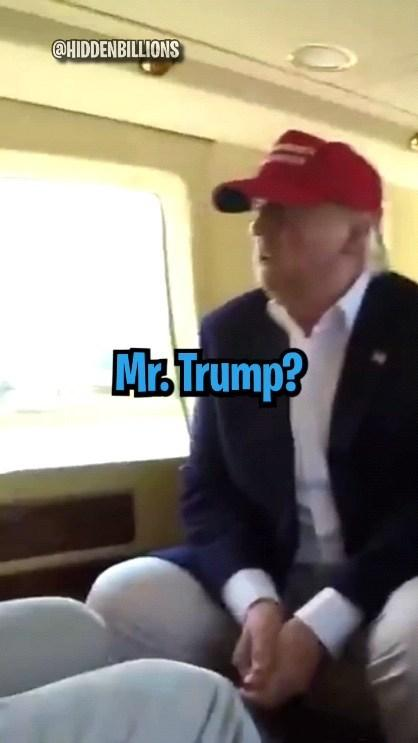

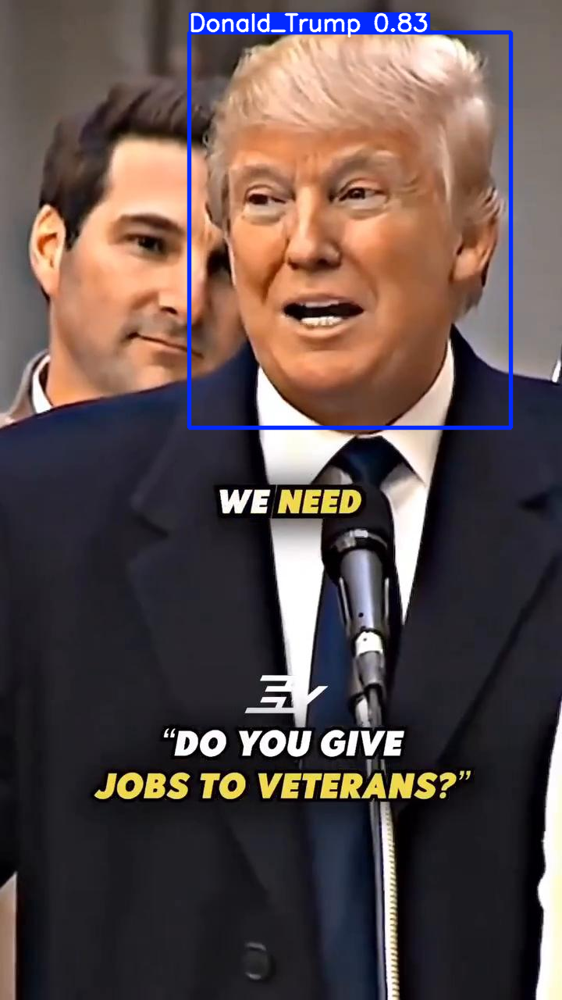

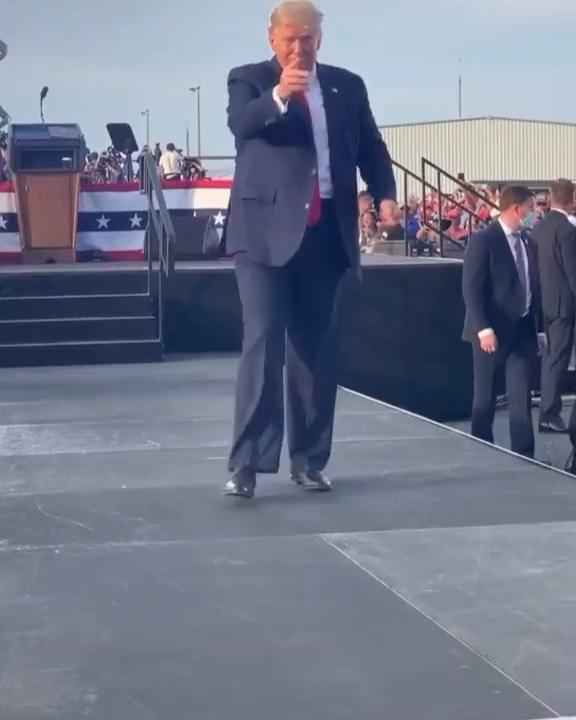

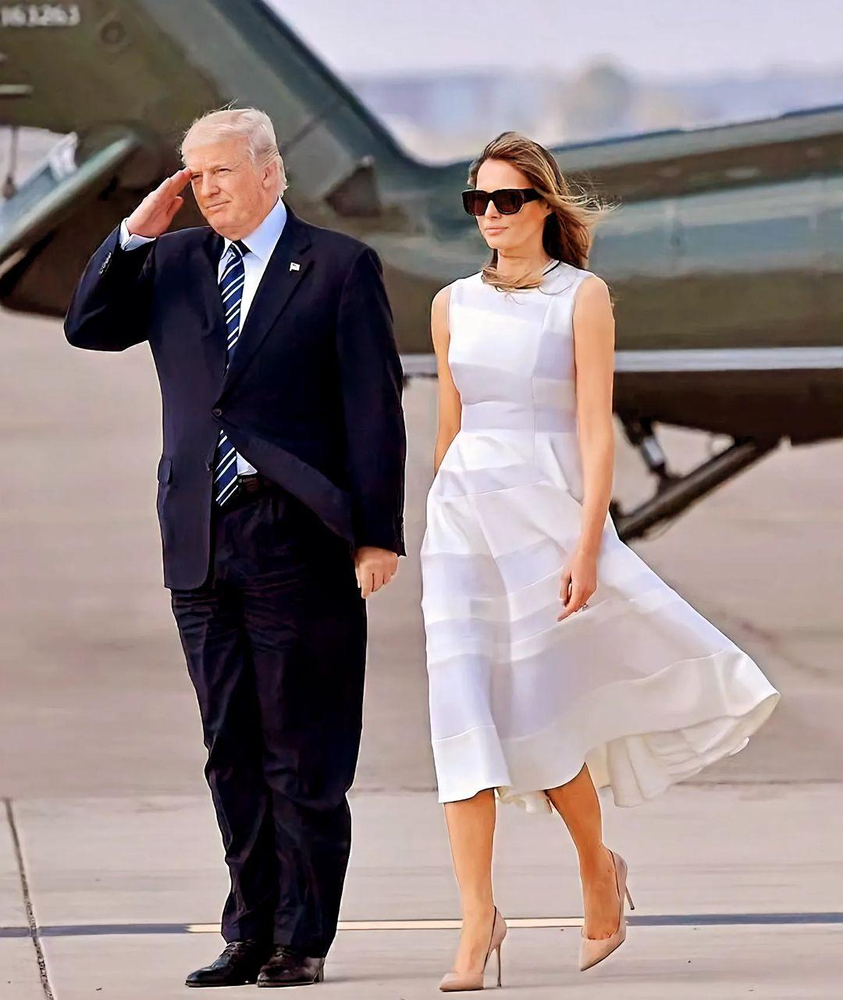

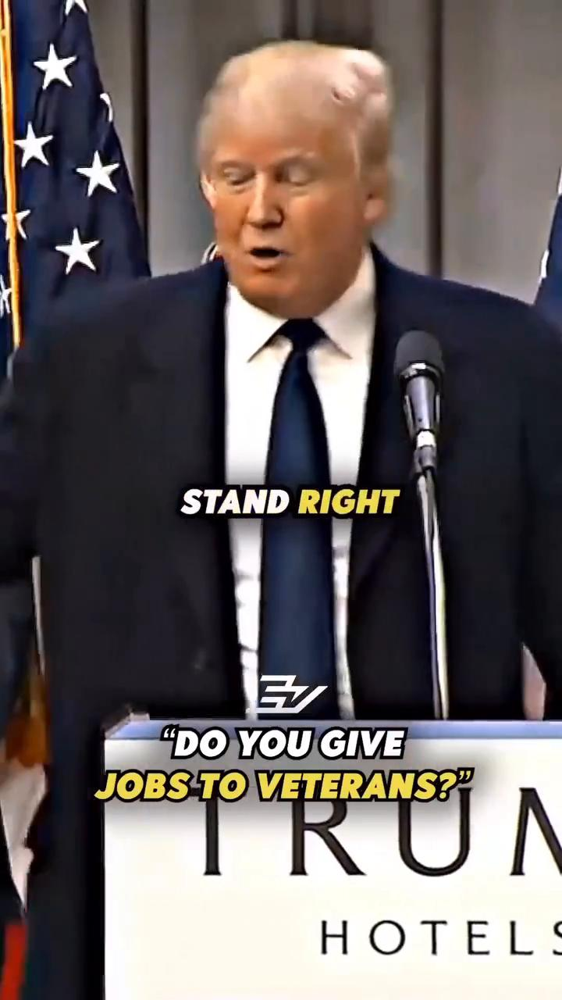

...

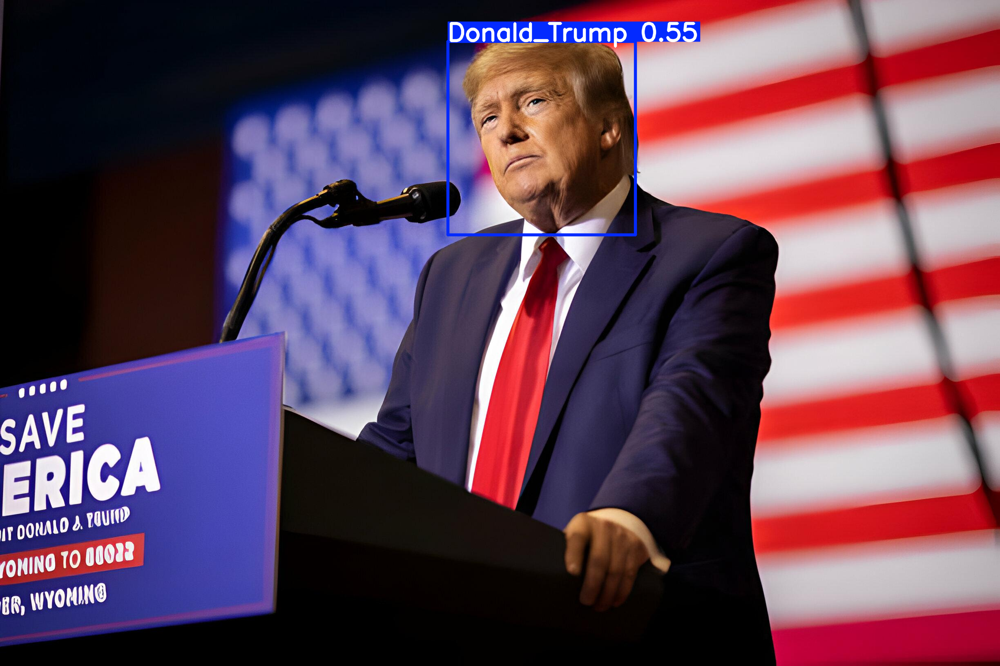

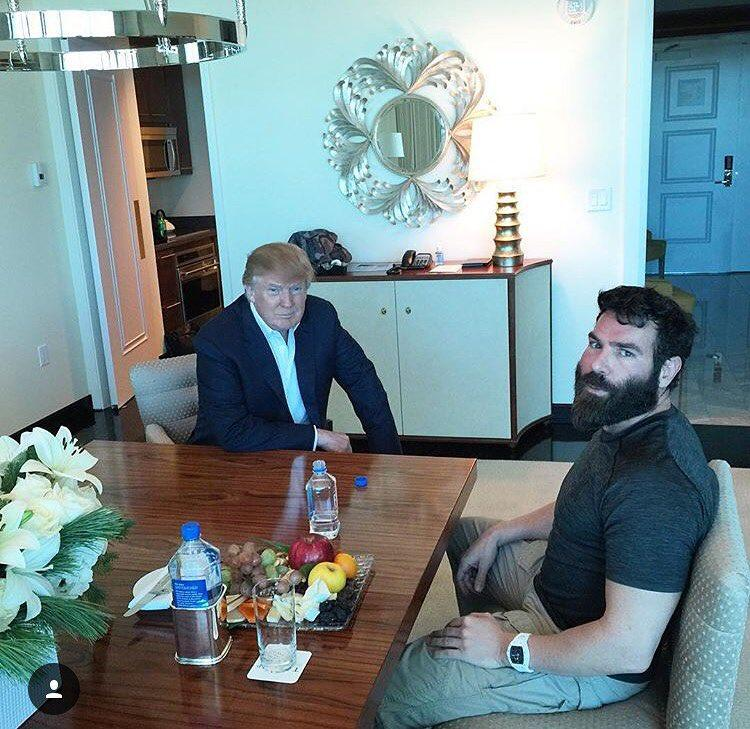

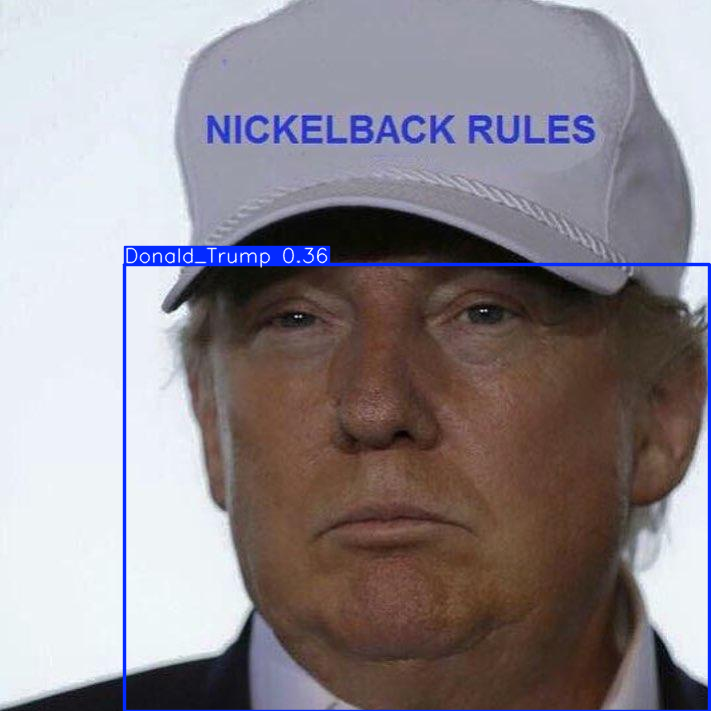

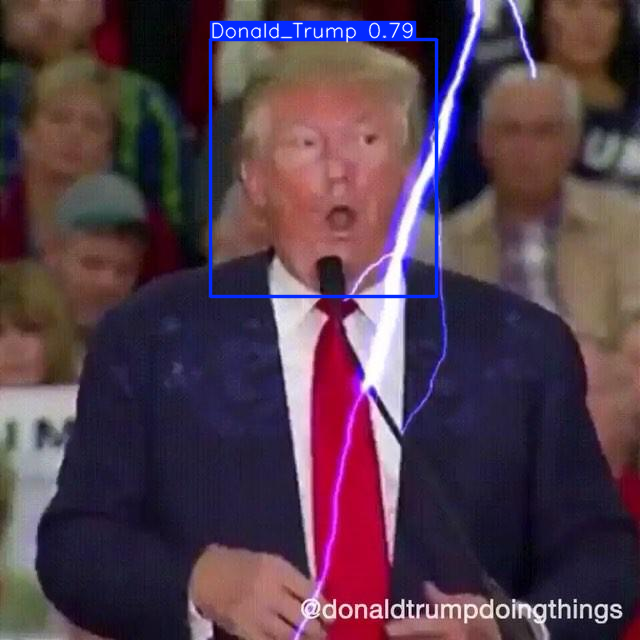

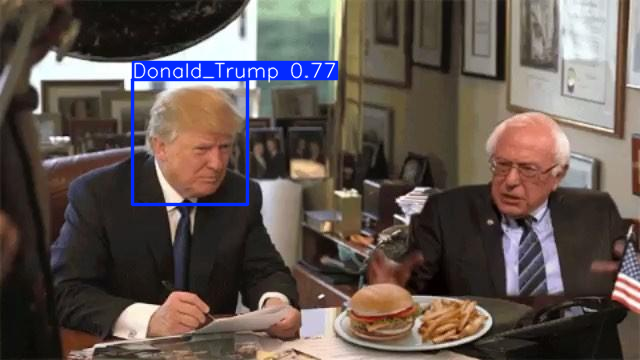

In [ ]:
import glob

# Load a model
model = YOLO("/content/runs/detect/trum_yolov8m2/weights/best.pt")  # pretrained YOLO11n model

# Define a glob search for all JPG files in a directory
source = "/content/Trump-2/test/images/*.jpg"

# OR define a recursive glob search for all JPG files including subdirectories
source = glob.glob("/content/Trump-2/test/images/*.jpg")
results = []
# 이미지 가져와서 예측하기
for img in source:
  result = model.predict(img, save=True, imgsz=320, conf=0.3)
  results.append(result)

# Process results list
for result in results:
    # result는 리스트 형태로 여러 결과를 포함하고 있음
    for single_result in result:  # 각 예측 결과를 처리
        boxes = single_result.boxes  # Boxes object for bounding box outputs
        masks = single_result.masks  # Masks object for segmentation masks outputs
        probs = single_result.probs  # Probs object for classification outputs
        obb = single_result.obb  # Oriented boxes object for OBB outputs
        single_result.show()  # display to screen
        single_result.save(filename="Trump-2_result.jpg")  # save to disk

In [ ]:
import glob
import os
from sklearn.metrics import precision_score, recall_score, f1_score

# Load a model
model = YOLO("/content/runs/detect/trum_yolov8m2/weights/best.pt")

source = glob.glob("/content/Trump-2/test/images/*.jpg")
label_source = "/content/Trump-2/test/labels"

y_true = []
y_pred = []

for img in source:
    # Load actual labels from .txt file
    label_file = os.path.join(label_source, os.path.basename(img).replace('.jpg', '.txt'))
    if os.path.exists(label_file):
        with open(label_file, 'r') as f:
            true_labels = f.readlines()
            true_classes = [int(line.strip().split()[0]) for line in true_labels]
            y_true.append(true_classes)
    else:
        print(f"Label file not found for image: {img}")

    # Model prediction
    result = model.predict(img, save=True, imgsz=640, conf=0.35)

    for r in result:
        if r.boxes is not None and len(r.boxes.cls) > 0:  # 예측 결과가 있을 경우
            predictions_with_classes = r.boxes.cls.tolist()
            predictions_with_confidence = r.boxes.conf.tolist()  # conf 리스트
            predict_cof_class = list(zip(predictions_with_classes, predictions_with_confidence))

            # 신뢰도가 높은 순으로 정렬
            predict_cof_class.sort(key=lambda x: x[1], reverse=True)

            # 예측 결과가 2개 이상일 경우, 신뢰도가 가장 높은 클래스 선택
            highest_confidence_class = int(predict_cof_class[0][0])  # 신뢰도 가장 높은 클래스
            y_pred.append([highest_confidence_class])  # 단일 요소 리스트로 추가
        else:
            y_pred.append([1])  # 예측 결과 없을 때 '1' 추가 (의도된 클래스인지 확인 필요)

# 리스트 평탄화
y_true_flat = [item for sublist in y_true for item in sublist]
y_pred_flat = [item for sublist in y_pred for item in sublist]

# 결과 평가
if len(y_true_flat) == len(y_pred_flat):
    precision = precision_score(y_true_flat, y_pred_flat, average='weighted', zero_division=1) # positive 클래스가 없을때 계산에 혼동이 없도록 설정 (zero_division)
    recall = recall_score(y_true_flat, y_pred_flat, average='weighted',zero_division=1)
    f1 = f1_score(y_true_flat, y_pred_flat, average='weighted',zero_division=1)

    print("Precision:", precision)
    print("Recall:", recall)
    print("F1 Score:", f1)
else:
    print("Inconsistent lengths between true and predicted labels.")



image 1/1 /content/Trump-2/test/images/2023-09-20_14-28-26_UTC_jpg.rf.97801f1625b54fb5f9d91a1491b88aa9.jpg: 640x384 (no detections), 24.2ms
Speed: 2.3ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

image 1/1 /content/Trump-2/test/images/2023-07-03_08-47-35_UTC_5_png.rf.c5dfa4504501d785056755bd28451b33.jpg: 640x384 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)

image 1/1 /content/Trump-2/test/images/2020-10-17_22-13-17_UTC_jpg.rf.dd1212a5932192d358b1407bfe7e2d66.jpg: 640x512 1 Donald_Trump, 25.9ms
Speed: 2.1ms preprocess, 25.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 512)

image 1/1 /content/Trump-2/test/images/2023-12-02_08-33-52_UTC_jpg.rf.30f927eaa6ec2b1e11bbd002f331ab42.jpg: 640x544 (no detections), 32.6ms
Speed: 2.6ms preprocess, 32.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 544)

image 1/1 /content/Trump-2/test/images/2023-07

In [ ]:
print(y_true_flat)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [ ]:
print(y_pred_flat)

[1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0]


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

cm = confusion_matrix(y_true_flat, y_pred_flat)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()
plt.sava("Trump_yolov8m2")


NameError: name 'y_true_flat' is not defined

클래스가 하나뿐일때

No positive class found in y_true, recall is set to one for all thresholds.


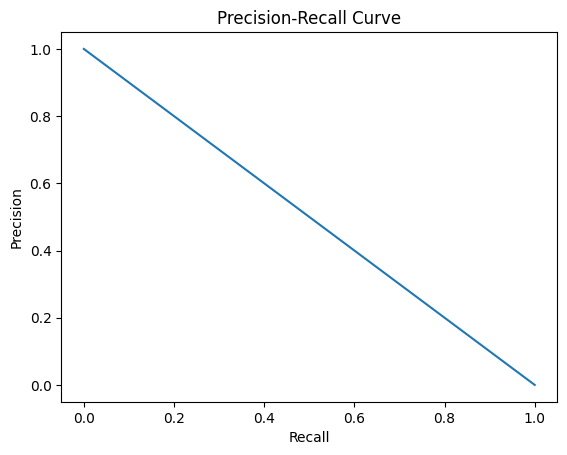

In [ ]:
#신뢰도값이 없어서
from sklearn.metrics import precision_recall_curve
import matplotlib.pyplot as plt

precision, recall, thresholds = precision_recall_curve(y_true_flat, y_pred_flat)  # y_pred_prob는 각 샘플에 대한 긍정 클래스 확률
plt.plot(recall, precision)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.show()


In [ ]:
from sklearn.metrics import accuracy_score

# Accuracy를 계산
accuracy = accuracy_score(y_true_flat, y_pred_flat)
print(f"Accuracy: {accuracy:.2f}")

Accuracy: 0.77


In [ ]:
source_dir = '/content/runs/detect/predict3'
zip_file_path = '/content/runs/detect/predict3.zip'

# Create a zip file from the directory
shutil.make_archive(zip_file_path.replace('.zip', ''), 'zip', source_dir)

files.download(zip_file_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Export the model
model.export()